<a href="https://colab.research.google.com/github/Pakeeru/Anomaly-Detection-Multivariate-Time-Series/blob/main/Anomaly_Detection_ECG_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install tslearn
!pip install scikit-fuzzy
import numpy as np
np.set_printoptions(suppress=True)
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.io import arff
from sklearn.model_selection import train_test_split
import matplotlib
matplotlib.rcParams["figure.figsize"] = (6, 4)
plt.style.use("ggplot")
import tensorflow as tf
from tensorflow import keras
from sklearn.metrics import accuracy_score, recall_score, precision_score, confusion_matrix, f1_score, classification_report
from sklearn.cluster import KMeans
import os
from tslearn.clustering import silhouette_score
from sklearn.decomposition import PCA
from tslearn.clustering import TimeSeriesKMeans
from tslearn.datasets import CachedDatasets
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 374.4/374.4 kB 3.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 994.0/994.0 kB 3.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for scikit-fuzzy: filename=scikit_fuzzy-0.4.2-py3-none-any.whl size=894077 sha256=0dff2876a15b27d93fe5cbf8c8f73b947b0920931ade114b17e6cf78621deb7b
  Stored in directory: /root/.cache/pip/wheels/4f/86/1b/dfd97134a2c8313e519bcebd95d3fedc7be7944db022094bc8
Successfully built scikit-fuzzy


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
df=pd.read_csv("/content/drive/MyDrive/ECG_Dataset/100.csv")
df.head()

,Unnamed: 0,time_ms,MLII,V5
0,0,0.000000,-0.145,-0.065
1,1,2.777778,-0.145,-0.065
2,2,5.555556,-0.145,-0.065
3,3,8.333333,-0.145,-0.065
4,4,11.111111,-0.145,-0.065


In [5]:
subsequence_length = 360

# Calculate the number of subsequences
num_subsequences = len(df) // subsequence_length

# Create an empty list to store the subsequences
subsequences = []

# Iterate through the dataframe and create subsequences
for i in range(num_subsequences):
    start_index = i * subsequence_length
    end_index = start_index + subsequence_length
    subsequence_df = df.iloc[start_index:end_index]
    subsequences.append(subsequence_df)

# Display the first subsequence as an example
print(subsequences[1])

     Unnamed: 0      time_ms   MLII     V5
360         360  1000.000000 -0.535 -0.205
361         361  1002.777778 -0.505 -0.080
362         362  1005.555556 -0.415  0.015
363         363  1008.333333 -0.300  0.065
364         364  1011.111111 -0.160  0.115
..          ...          ...    ...    ...
715         715  1986.111111 -0.390 -0.255
716         716  1988.888889 -0.400 -0.270
717         717  1991.666667 -0.400 -0.280
718         718  1994.444444 -0.415 -0.290
719         719  1997.222222 -0.425 -0.290

[360 rows x 4 columns]


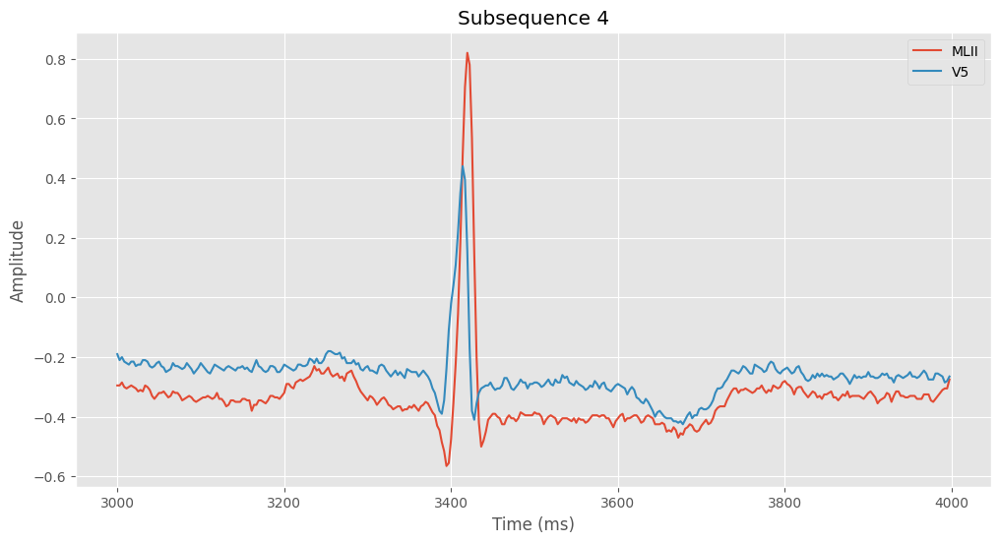

In [6]:
import matplotlib.pyplot as plt

# Assuming 'subsequences' is the list containing subsequences from the previous code snippet

# Select the index of the subsequence you want to plot
subsequence_index = 3  # Change this to the desired subsequence index

# Check if the selected subsequence index is valid
if subsequence_index < len(subsequences):
    selected_subsequence = subsequences[subsequence_index]

    # Plot 'MLII' and 'V5' for the selected subsequence
    plt.figure(figsize=(12, 6))
    plt.plot(selected_subsequence['time_ms'], selected_subsequence['MLII'], label='MLII')
    plt.plot(selected_subsequence['time_ms'], selected_subsequence['V5'], label='V5')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')
    plt.title(f'Subsequence {subsequence_index + 1}')
    plt.legend()
    plt.show()
else:
    print(f"Invalid subsequence index. There are {len(subsequences)} subsequences available.")



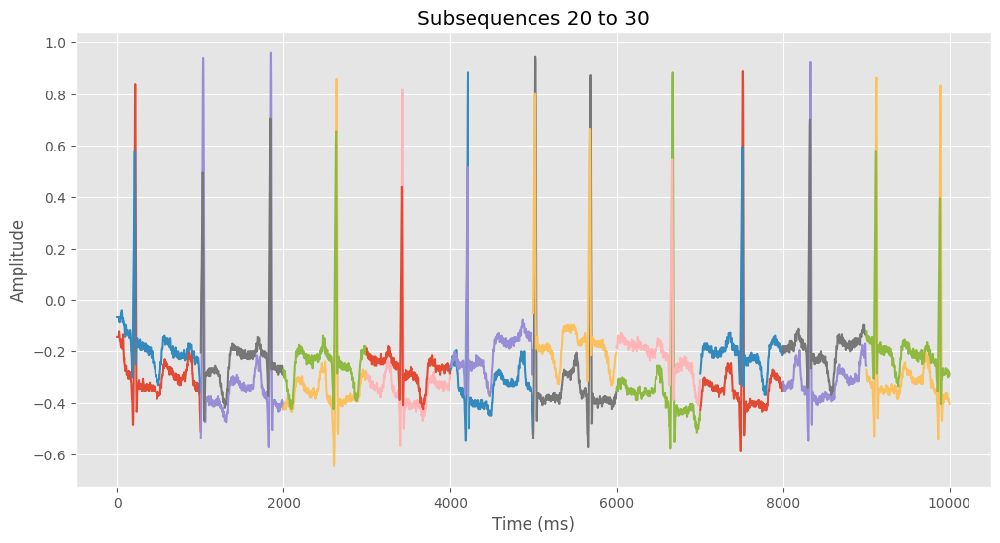

In [7]:
import matplotlib.pyplot as plt

# Assuming 'subsequences' is the list containing subsequences from the previous code snippet

# Select the starting index of the group you want to plot
group_start_index = 0  # Change this to the desired starting index

# Check if the selected group start index is valid
if group_start_index + 9 < len(subsequences):
    # Select 10 subsequences starting from the group start index
    selected_group = subsequences[group_start_index:group_start_index + 10]

    # Plot 'MLII' and 'V5' for each subsequence in the group
    plt.figure(figsize=(12, 6))
    for i, subsequence in enumerate(selected_group):
        plt.plot(subsequence['time_ms'], subsequence['MLII'], label=f'MLII - Subsequence {group_start_index + i + 1}')
        plt.plot(subsequence['time_ms'], subsequence['V5'], label=f'V5 - Subsequence {group_start_index + i + 1}')

    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')
    plt.title(f'Subsequences {group_start_index + 20} to {group_start_index + 30}')

    plt.show()
else:
    print(f"Invalid group start index. There are {len(subsequences)} subsequences available.")


#Feature Extraction from subsequences

In [8]:
# I'm standardizing the EKG signals to have a mean of 0 and a standard deviation of 1.
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

if 'MLII' in df.columns:
    df['MLII'] = scaler.fit_transform(df[['MLII']])
if 'V5' in df.columns:
    df['V5'] = scaler.fit_transform(df[['V5']])

In [9]:
from scipy.signal import find_peaks

# Assuming you have 'subsequences' list from the previous code snippet

# Create an empty list to store the features for each subsequence
features_list = []

# Iterate through each subsequence
for i, subsequence_df in enumerate(subsequences):
    lead_data = subsequence_df['MLII']  # Replace 'MLII' with the actual column name in your dataframe

    # Find peaks using a peak detection algorithm (you may need to adjust parameters)
    peaks, _ = find_peaks(lead_data)

    # Calculate intervals between consecutive peaks
    intervals = np.diff(peaks)

    # Ensure that there are peaks and intervals to calculate features
    if len(peaks) > 0 and len(intervals) > 0:
        # Extracting features using integer locations of peaks
        max_peak = np.max(lead_data.iloc[peaks])
        min_peak = np.min(lead_data.iloc[peaks])
        mean_interval = np.mean(intervals)
    else:
        max_peak, min_peak, mean_interval = 0, 0, 0

    # Calculate F6: Linearity
    linearity = np.sum(np.square(np.diff(lead_data)))

    # Calculate F7: Curvature
    quadratic_regression = np.polyfit(np.arange(len(lead_data)), lead_data, 2)
    curvature = np.sum(np.square(lead_data - np.polyval(quadratic_regression, np.arange(len(lead_data)))))

    # Calculate F8: Spikiness
    spikiness = np.std(np.diff(np.diff(lead_data)))

    # Append features to the list
    features_list.append([max_peak, min_peak, mean_interval, linearity, curvature, spikiness])

# Create a dataframe from the features list
features_df = pd.DataFrame(features_list, columns=['Max Peak', 'Min Peak', 'Mean Interval', 'Linearity', 'Curvature', 'Spikiness'])

# Display the resulting dataframe
print(features_df)



      Max Peak  Min Peak  Mean Interval  Linearity  Curvature  Spikiness
0        0.840    -0.360       5.406250   0.638675   6.713301   0.024333
1        0.960    -0.450       5.476190   1.467000  17.507915   0.032951
2        0.860    -0.430       5.348485   0.772375   7.735923   0.026640
3        0.820    -0.455       5.421875   0.710550   6.747431   0.026272
4        0.885    -0.440       5.783333   0.742150   7.834976   0.025349
...        ...       ...            ...        ...        ...        ...
1800     0.880    -0.445       5.176471   0.771725   9.275099   0.025070
1801     0.995    -0.465       5.883333   0.836875  11.725235   0.026830
1802     1.000    -0.385       5.564516   1.836750  16.052985   0.039811
1803     0.910    -0.395       5.421875   0.831775   7.757883   0.027567
1804     0.930    -0.480       5.453125   1.685675  15.970452   0.037112

[1805 rows x 6 columns]


#Isolation Forest Anomaly Detection

In [10]:
from sklearn.ensemble import IsolationForest
import pandas as pd
import numpy as np

# Assuming 'features_df' contains the features calculated from your code

# Selecting the features for anomaly detection
selected_features = features_df[['Max Peak', 'Min Peak', 'Mean Interval', 'Linearity', 'Curvature', 'Spikiness']]

# Creating and fitting the Isolation Forest model
isolation_forest = IsolationForest(contamination=0.1, random_state=42)  # Adjust contamination as needed
isolation_forest.fit(selected_features)

# Predicting anomalies (1 for normal, -1 for anomalies)
anomaly_predictions = isolation_forest.predict(selected_features)

# Adding a new column 'IsolationForestAnomaly' to the dataframe
features_df['IsolationForestAnomaly'] = (anomaly_predictions == -1)

# Displaying the dataframe with the Isolation Forest anomaly predictions
print(features_df)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


      Max Peak  Min Peak  Mean Interval  Linearity  Curvature  Spikiness  \
0        0.840    -0.360       5.406250   0.638675   6.713301   0.024333   
1        0.960    -0.450       5.476190   1.467000  17.507915   0.032951   
2        0.860    -0.430       5.348485   0.772375   7.735923   0.026640   
3        0.820    -0.455       5.421875   0.710550   6.747431   0.026272   
4        0.885    -0.440       5.783333   0.742150   7.834976   0.025349   
...        ...       ...            ...        ...        ...        ...   
1800     0.880    -0.445       5.176471   0.771725   9.275099   0.025070   
1801     0.995    -0.465       5.883333   0.836875  11.725235   0.026830   
1802     1.000    -0.385       5.564516   1.836750  16.052985   0.039811   
1803     0.910    -0.395       5.421875   0.831775   7.757883   0.027567   
1804     0.930    -0.480       5.453125   1.685675  15.970452   0.037112   

      IsolationForestAnomaly  
0                      False  
1                      Fa

In [11]:
import plotly.graph_objects as go

# Assuming 'subsequences', 'features_df', and 'patient_data' are available

# Create a figure
fig = go.Figure()

# Iterate over all subsequences
for subsequence_index, selected_subsequence in enumerate(subsequences):
    ml_ii_color = 'red'
    v5_color = 'blue'

    # Add 'MLII' and 'V5' for the subsequence
    fig.add_trace(go.Scatter(x=selected_subsequence['time_ms'], y=selected_subsequence['MLII'], mode='lines', name=f'MLII - Subsequence {subsequence_index + 1}', legendgroup=f'Subsequence {subsequence_index + 1}', line=dict(color=ml_ii_color)))
    fig.add_trace(go.Scatter(x=selected_subsequence['time_ms'], y=selected_subsequence['V5'], mode='lines', name=f'V5 - Subsequence {subsequence_index + 1}', legendgroup=f'Subsequence {subsequence_index + 1}', line=dict(color=v5_color)))

    # Check if the subsequence has an Isolation Forest anomaly
    if features_df.at[subsequence_index, 'IsolationForestAnomaly']:
        anomaly_color = 'yellow'
        anomaly_name = f'Anomaly {subsequence_index + 1}'
        # Overlay the anomaly on the subsequence if present
        fig.add_trace(go.Scatter(x=selected_subsequence['time_ms'], y=selected_subsequence['MLII'], mode='lines', name=anomaly_name, legendgroup=f'Subsequence {subsequence_index + 1}', line=dict(color=anomaly_color)))

# Enhance the plot with user-friendly features like tooltips and annotations
fig.update_layout(
    title="EKG Signal with Isolation Forest Anomalies",
    xaxis_title="Time (in milliseconds)",
    yaxis_title="Amplitude",

)


# Show the plot
fig.show()


#K-means Clustering and Anomaly Detection

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will chang

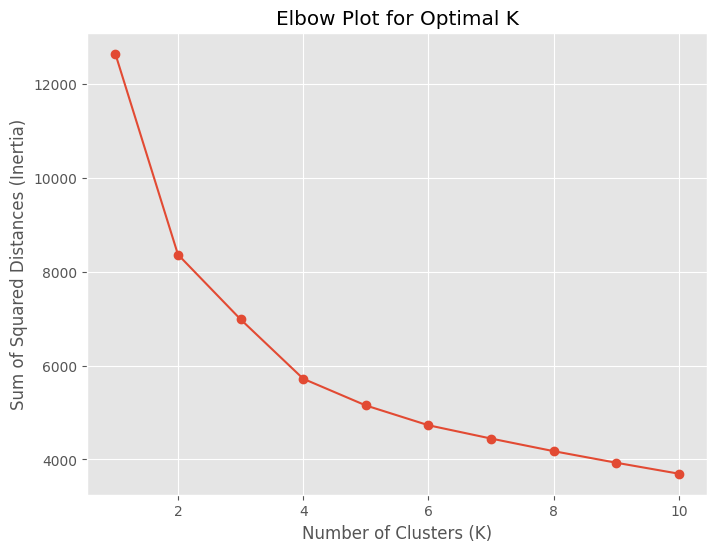

In [12]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Standardize the features before clustering
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features_df)

# Calculate the sum of squared distances for different values of k
inertia = []
for k in range(1, 11):  # You can adjust the range of clusters
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(scaled_features)
    inertia.append(kmeans.inertia_)

# Plot the elbow curve
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), inertia, marker='o')
plt.title('Elbow Plot for Optimal K')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Sum of Squared Distances (Inertia)')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



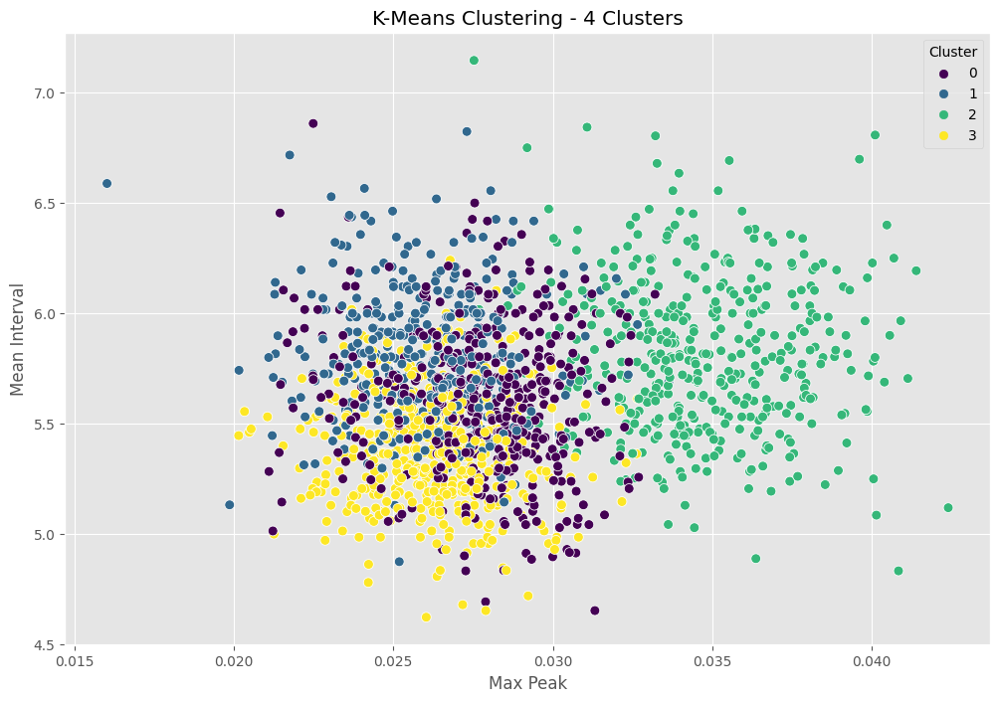

In [13]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns


# Standardize the features before clustering
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features_df[['Max Peak', 'Min Peak', 'Mean Interval','Linearity', 'Curvature', 'Spikiness']])

# Fit KMeans with 5 clusters (or the optimal number from the elbow plot)
kmeans = KMeans(n_clusters=4, random_state=42)
features_df['K-means Cluster'] = kmeans.fit_predict(scaled_features)


# Plot clusters using seaborn
plt.figure(figsize=(12, 8))
sns.scatterplot(x='Spikiness', y='Mean Interval', hue='K-means Cluster', data=features_df, palette='viridis', s=50)
plt.title('K-Means Clustering - 4 Clusters')
plt.xlabel('Max Peak')
plt.ylabel('Mean Interval')
plt.legend(title='Cluster')
plt.show()

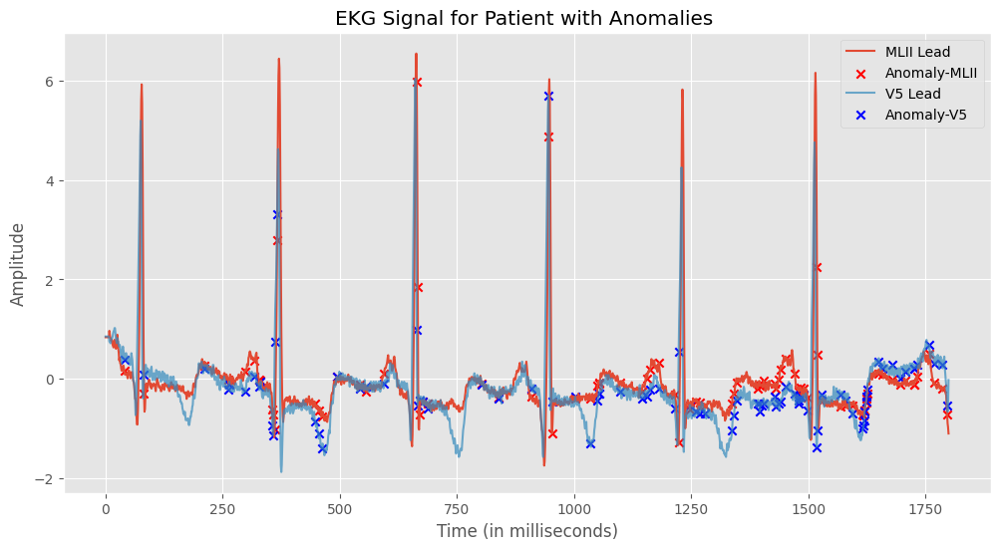

In [14]:
# Assuming 'scaled_features', 'kmeans', and 'features_df' are defined

# Calculate distances to cluster centroids
distances = np.min(kmeans.transform(scaled_features), axis=1)

# Set a threshold for anomaly detection (you may need to adjust this threshold)
threshold = np.percentile(distances, 95)

# Identify anomalies based on the threshold
features_df['K-means Anomaly'] = distances > threshold

# Create a common time index for both df and features_df
common_index = df.index.intersection(features_df.index)

# Plotting EKG signals and overlaying anomaly markers
plt.figure(figsize=(12, 6))

# Check if 'MLII' exists in the columns
if 'MLII' in df.columns:
    # Plotting the first 1800 samples of the MLII Lead if it exists in the dataframe.
    plt.plot(df['MLII'][:1800], label='MLII Lead')  # Plotting first 5 seconds of data (assuming 360 Hz sample rate)

    # Overlay anomaly markers based on the 'K-means Anomaly' column in features_df
    anomaly_mask = common_index.isin(features_df.index) & features_df['K-means Anomaly']
    plt.scatter(common_index[anomaly_mask], df.loc[common_index]['MLII'][anomaly_mask], color='red', marker='x', label='Anomaly-MLII')

# Check if 'V5' exists in the columns
if 'V5' in df.columns:
    # Similarly, plotting the first 1800 samples of the V5 Lead if it exists.
    plt.plot(df['V5'][:1800], label='V5 Lead', alpha=0.7)

    # Overlay anomaly markers based on the 'K-means Anomaly' column in features_df
    anomaly_mask = common_index.isin(features_df.index) & features_df['K-means Anomaly']
    plt.scatter(common_index[anomaly_mask], df.loc[common_index]['V5'][anomaly_mask], color='blue', marker='x', label='Anomaly-V5')

plt.title(f"EKG Signal for Patient with Anomalies ")
plt.xlabel("Time (in milliseconds)")
plt.ylabel("Amplitude")
plt.legend()
plt.show()


In [15]:
print(features_df)

      Max Peak  Min Peak  Mean Interval  Linearity  Curvature  Spikiness  \
0        0.840    -0.360       5.406250   0.638675   6.713301   0.024333   
1        0.960    -0.450       5.476190   1.467000  17.507915   0.032951   
2        0.860    -0.430       5.348485   0.772375   7.735923   0.026640   
3        0.820    -0.455       5.421875   0.710550   6.747431   0.026272   
4        0.885    -0.440       5.783333   0.742150   7.834976   0.025349   
...        ...       ...            ...        ...        ...        ...   
1800     0.880    -0.445       5.176471   0.771725   9.275099   0.025070   
1801     0.995    -0.465       5.883333   0.836875  11.725235   0.026830   
1802     1.000    -0.385       5.564516   1.836750  16.052985   0.039811   
1803     0.910    -0.395       5.421875   0.831775   7.757883   0.027567   
1804     0.930    -0.480       5.453125   1.685675  15.970452   0.037112   

      IsolationForestAnomaly  K-means Cluster  K-means Anomaly  
0                     



---



#FUZZY C-MEANS CLUSTERING

In [16]:
import numpy as np
import skfuzzy as fuzz

# Assuming 'features_df' is a DataFrame containing features for each subsequence

# Select a subset of features for clustering
selected_features = features_df[['Max Peak', 'Min Peak', 'Mean Interval', 'Linearity', 'Curvature', 'Spikiness']].values

# Normalize the features (if needed)
# You can use sklearn.preprocessing.StandardScaler for normalization

# Set the number of clusters
num_clusters = 4  # Adjust as needed

# Apply fuzzy c-means clustering
cntr, u, _, _, _, _, _ = fuzz.cluster.cmeans(selected_features.T, num_clusters, 2, error=0.005, maxiter=1000)

# Identify cluster memberships
cluster_memberships = np.argmax(u, axis=0)

# Add cluster memberships to the original DataFrame
features_df['Fuzzy Cluster'] = cluster_memberships

# Print or analyze the results
print(features_df[['Max Peak', 'Min Peak', 'Mean Interval', 'Linearity', 'Curvature', 'Spikiness', 'Fuzzy Cluster']])


      Max Peak  Min Peak  Mean Interval  Linearity  Curvature  Spikiness  \
0        0.840    -0.360       5.406250   0.638675   6.713301   0.024333   
1        0.960    -0.450       5.476190   1.467000  17.507915   0.032951   
2        0.860    -0.430       5.348485   0.772375   7.735923   0.026640   
3        0.820    -0.455       5.421875   0.710550   6.747431   0.026272   
4        0.885    -0.440       5.783333   0.742150   7.834976   0.025349   
...        ...       ...            ...        ...        ...        ...   
1800     0.880    -0.445       5.176471   0.771725   9.275099   0.025070   
1801     0.995    -0.465       5.883333   0.836875  11.725235   0.026830   
1802     1.000    -0.385       5.564516   1.836750  16.052985   0.039811   
1803     0.910    -0.395       5.421875   0.831775   7.757883   0.027567   
1804     0.930    -0.480       5.453125   1.685675  15.970452   0.037112   

      Fuzzy Cluster  
0                 1  
1                 2  
2                 1  

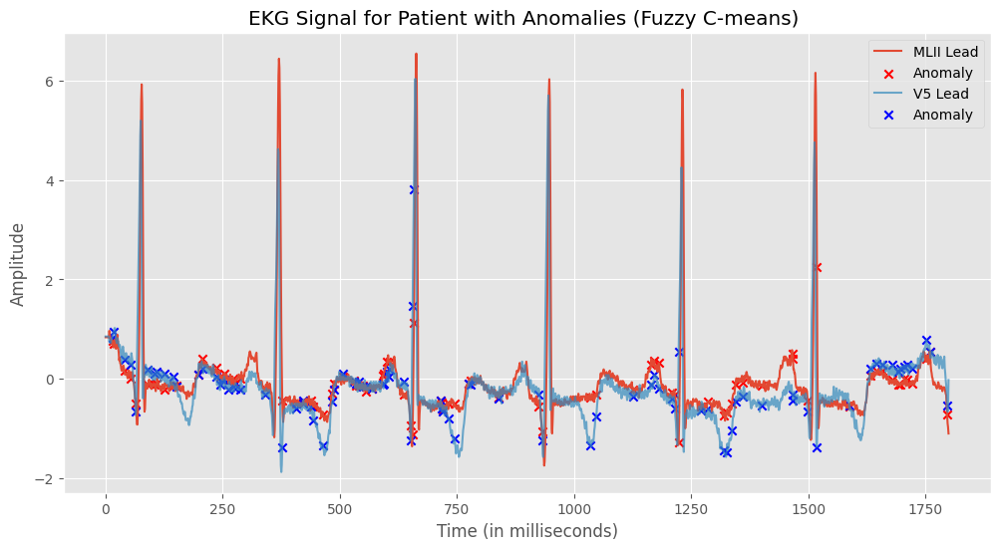

In [17]:

# Calculate the distance to the cluster centroids
distances = np.min(u, axis=0)

# Set a threshold for anomaly detection (you may need to adjust this threshold)
threshold = np.percentile(distances, 95)

# Identify anomalies based on the threshold
features_df['Fuzzy C-means Anomaly'] = distances > threshold

# Create a common time index for both df and features_df
common_index = df.index.intersection(features_df.index)

# Plot only the first 1800 samples
plot_limit = 1800

# Iterate through patients and overlay anomaly markers on EKG time series plots
plt.figure(figsize=(12, 6))

# Check if 'MLII' exists in the columns
if 'MLII' in df.columns:
    # Plotting the first 1800 samples of the MLII Lead if it exists in the dataframe.
    plt.plot(df['MLII'][:plot_limit], label='MLII Lead')  # Plotting the first 1800 samples

    # Overlay anomaly markers based on the 'Fuzzy C-means Anomaly' column in features_df
    anomaly_mask = common_index.isin(features_df.index) & features_df['Fuzzy C-means Anomaly']
    plt.scatter(common_index[anomaly_mask][:plot_limit], df.loc[common_index]['MLII'][anomaly_mask][:plot_limit], color='red', marker='x', label='Anomaly')

# Check if 'V5' exists in the columns
if 'V5' in df.columns:
    # Similarly, plotting the first 1800 samples of the V5 Lead if it exists.
    plt.plot(df['V5'][:plot_limit], label='V5 Lead', alpha=0.7)

    # Overlay anomaly markers based on the 'Fuzzy C-means Anomaly' column in features_df
    anomaly_mask = common_index.isin(features_df.index) & features_df['Fuzzy C-means Anomaly']
    plt.scatter(common_index[anomaly_mask][:plot_limit], df.loc[common_index]['V5'][anomaly_mask][:plot_limit], color='blue', marker='x', label='Anomaly')

plt.title(f"EKG Signal for Patient with Anomalies (Fuzzy C-means) ")
plt.xlabel("Time (in milliseconds)")
plt.ylabel("Amplitude")
plt.legend()
plt.show()


In [18]:
print(features_df)

      Max Peak  Min Peak  Mean Interval  Linearity  Curvature  Spikiness  \
0        0.840    -0.360       5.406250   0.638675   6.713301   0.024333   
1        0.960    -0.450       5.476190   1.467000  17.507915   0.032951   
2        0.860    -0.430       5.348485   0.772375   7.735923   0.026640   
3        0.820    -0.455       5.421875   0.710550   6.747431   0.026272   
4        0.885    -0.440       5.783333   0.742150   7.834976   0.025349   
...        ...       ...            ...        ...        ...        ...   
1800     0.880    -0.445       5.176471   0.771725   9.275099   0.025070   
1801     0.995    -0.465       5.883333   0.836875  11.725235   0.026830   
1802     1.000    -0.385       5.564516   1.836750  16.052985   0.039811   
1803     0.910    -0.395       5.421875   0.831775   7.757883   0.027567   
1804     0.930    -0.480       5.453125   1.685675  15.970452   0.037112   

      IsolationForestAnomaly  K-means Cluster  K-means Anomaly  Fuzzy Cluster  \
0     

In [ ]:
# Count the number of isolation forest anomalies
isolation_forest_anomaly_count = features_df['IsolationForestAnomaly'].sum()

# Display the count of isolation forest anomalies
print("Number of Isolation Forest anomalies:", isolation_forest_anomaly_count)


Number of Isolation Forest anomalies: 181


In [ ]:
# Count the number of anomalies for each cluster
anomaly_counts = features_df.groupby('K-means Cluster')['K-means Anomaly'].sum()

# Identify the cluster with the highest number of anomalies
most_anomalies_cluster = anomaly_counts.idxmax()

# Display the count of anomalies for each cluster
print("Number of anomalies in each cluster:")
print(anomaly_counts)

# Display the cluster with the highest number of anomalies
print("\nCluster with the highest number of anomalies:", most_anomalies_cluster)

Number of anomalies in each cluster:
K-means Cluster
0    17
1    16
2    55
3     3
Name: K-means Anomaly, dtype: int64

Cluster with the highest number of anomalies: 2


In [ ]:
# Count the number of anomalies for each fuzzy c-means cluster
fuzzy_anomaly_counts = features_df.groupby('Fuzzy Cluster')['Fuzzy C-means Anomaly'].sum()

# Identify the cluster with the highest number of anomalies for fuzzy c-means
most_fuzzy_anomalies_cluster = fuzzy_anomaly_counts.idxmax()

# Display the count of anomalies for each fuzzy c-means cluster
print("Number of anomalies in each fuzzy c-means cluster:")
print(fuzzy_anomaly_counts)

# Display the fuzzy c-means cluster with the highest number of anomalies
print("\nCluster with the highest number of anomalies for fuzzy c-means:", most_fuzzy_anomalies_cluster)


Number of anomalies in each fuzzy c-means cluster:
Fuzzy Cluster
0    59
1    23
2     9
3     0
Name: Fuzzy C-means Anomaly, dtype: int64

Cluster with the highest number of anomalies for fuzzy c-means: 0


In [ ]:
# Filter for subsequences with anomalies in all three methods
all_anomalies = features_df[(features_df['IsolationForestAnomaly'] == True) &
                            (features_df['K-means Anomaly'] == True) &
                            (features_df['Fuzzy C-means Anomaly'] == True)]

# Count the number of subsequences with anomalies in all three methods
count_all_anomalies = len(all_anomalies)

# Print the count
print(f"Count of Subsequences with Anomalies in Isolation Forest, K-means, and Fuzzy C-means: {count_all_anomalies}")


Count of Subsequences with Anomalies in Isolation Forest, K-means, and Fuzzy C-means: 13


In [ ]:
 print(all_anomalies)

      Max Peak  Min Peak  Mean Interval  Linearity  Curvature  Spikiness  \
40       0.770    -0.490       5.147059   1.338725  13.414847   0.032165   
262      1.245    -0.245       6.122807   0.794375  13.527460   0.023524   
556      1.140    -0.550       5.770492   1.488425  27.205100   0.034478   
594      0.775    -0.515       6.210526   1.333150  14.093975   0.030964   
839      1.255    -0.500       6.303571   1.815925  28.096223   0.034461   
1181     1.240    -0.360       5.446154   1.727975  26.973095   0.034112   
1215     1.060    -0.445       4.888889   1.378325  14.016709   0.036364   
1223     1.170    -0.500       5.353846   1.819875  28.089446   0.035061   
1337     1.370    -0.495       5.205882   1.903800  26.947916   0.036140   
1401     1.200    -0.405       5.119403   2.018250  26.496837   0.042393   
1518     0.960    -0.470       7.145833   1.725500  78.505981   0.027528   
1680     1.330    -0.440       6.035088   1.669800  26.690681   0.030986   
1796     1.2